In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import LeaveOneOut
from scipy.interpolate import UnivariateSpline
import statsmodels.api as sm
import glob
import os
import numpy as np
import seaborn as sns

import matplotlib.style as style
import matplotlib.cm as cm
# style.use('seaborn-v0_8-poster')  # or 'default' (style.available to list styles)
style.use('default')

# Change the default math mode font to normal
plt.rcParams['mathtext.default'] = 'regular'

# Explore regressions between grab sample chemistry data and continuous data

Aims:
* Read in cleaned water chemistry data (all 3 rivers), river discharge data (all 3 rivers) and NIVA sensor data (Glomma only)
* For all three rivers, look for regressions between water chemistry data and river discharge. Potentially try seasonal regressions too (e.g. might expect different relationships in spring snow melt than during autumn)
* For Glomma, look for regressions between water chemistry data and sensor data. Hope to find relationships between SPM and turbidity, between FDOM and DOC (and lab CDOM data if we have it). Might find some relationships between e.g. conductivity and NOx, so just a general screening is a good idea too.

# 1. User input

In [ ]:
# Folders for storing output
ts_folder = r"../figures/timeseries/chem_and_qsim"
daily_chem_folder = r"../figures/timeseries/daily_chem"
flux_figure_folder = r"../figures/timeseries/fluxes"

In [ ]:
wc_vars = ['DOC_mg/L C',  'Farge_mg Pt/l', 'NH4-N_�g/l', 'NO3-N_�g/l', 'P-PO4_�g/l P', 'PO4-P_�g/l',  'STS_mg/l',
           'SiO2_mg/l', 'TOC_mg/l', 'TOTN_�g/l', 'TOTP/F_�g/l P', 'TOTP_P_�g/l P',  'TSM_mg/l', 'UV-Abs. 410nm_Abs/cm']

sensor_vars = ['CDOMdigitalFinal (�g/L)', 'PhValue_Avg (-)', 'Temp_water_Avg (degC)', 'CondValue_Avg (�S/cm)', 'Turbidity_Avg (NTU)', 'Salinity_Avg (-)']


station_mapping = {
    'Drammenselva': {
        'chem_station': 'Drammenselva v/Krokstadelva',
        'discharge_column': 'discharge_Drammenselva v/Krokstadelva'
    },
    'Numedalsl�gen': {
        'chem_station': 'Numedalsl�gen v/E18',
        'discharge_column': 'discharge_Numedalsl�gen v/E18'
    },
    'Glomma': {
        'chem_station': 'Glomma v/Sarpefossen',
        'discharge_column': 'discharge_Glomma v/Sarpefossen'
    }
}

chem_units_dict = {
    "SPM": r"$mg\;l^{-1}$",
    "DOC": r"$mg\;l^{-1}$",
    "TDN": r"$\mu g \; l^{-1}$",
    "NOx-N": r"$\mu g \; l^{-1}$",
    "NH4-N": r"$\mu g \; l^{-1}$",
    "SiO2": r"$\mu g \; l^{-1}$",
    "DON": r"$\mu g \; l^{-1}$"
}

# 2. Read in data

## Chem data

In [ ]:
infile = r'../../data/river/water_chem/cleaned_niva/dremmen_glomma_numed_wc_flagged_2024.csv'
chem_df = pd.read_csv(infile)

# Convert 'sample_date' to datetime format
chem_df['sample_date'] = pd.to_datetime(chem_df['sample_date'])
chem_df.set_index('sample_date', inplace=True)

chem_df.head()

,station_id,station_code,station_name,DOC_mg/L C,outlier_DOC_mg/L C,Farge_mg Pt/l,outlier_Farge_mg Pt/l,NH4-N_�g/l,outlier_NH4-N_�g/l,NO3-N_�g/l,...,TOTN_�g/l,outlier_TOTN_�g/l,TOTP/F_�g/l P,outlier_TOTP/F_�g/l P,TOTP_P_�g/l P,outlier_TOTP_P_�g/l P,TSM_mg/l,outlier_TSM_mg/l,UV-Abs. 410nm_Abs/cm,outlier_UV-Abs. 410nm_Abs/cm
sample_date,,,,,,,,,,,,,,,,,,,,,
1990-01-11,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,235.0,...,350.0,False,NaN,NaN,NaN,NaN,0.8,False,NaN,NaN
1990-02-12,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,295.0,...,419.0,False,NaN,NaN,NaN,NaN,2.0,False,NaN,NaN
1990-03-13,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,265.0,...,405.0,False,NaN,NaN,NaN,NaN,1.4,False,NaN,NaN
1990-04-18,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,270.0,...,399.0,False,NaN,NaN,NaN,NaN,1.3,False,NaN,NaN
1990-05-21,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,178.0,...,317.0,False,NaN,NaN,NaN,NaN,1.7,False,NaN,NaN


## Q data

In [ ]:
directory = r'../../data/river/discharge/clean'

# Get a list of all CSV files in the directory
csv_files = glob.glob(os.path.join(directory, '*.csv'))

# Dictionary to map file names to river names
river_names = {
    'Q_daily-mean_Drammenselva_Mj�ndalen bru_12': 'discharge_Drammenselva v/Krokstadelva',
    'Q_daily-mean_Glomma_Solbergfoss_2': 'discharge_Glomma v/Sarpefossen',
    'Q_daily-mean_Numedalsl�gen_Holmfoss_15': 'discharge_Numedalsl�gen v/E18'
}

# Initialize an empty DataFrame to hold the combined data
discharge_df = pd.DataFrame()

# Loop through each file and process it
for file in csv_files:
    # Extract the river name from the file name
    river_name = os.path.basename(file).split('.')[0]

    # Read the CSV file
    df = pd.read_csv(file)

     # Select the Date and discharge columns, and rename the discharge column
    discharge_column = df[['Date', 'Discharge']].rename(columns={'Discharge': river_names[river_name]})

    # Merge the discharge columns on the Date column
    if discharge_df.empty:
        discharge_df = discharge_column
    else:
        discharge_df = pd.merge(discharge_df, discharge_column, on='Date', how='outer')


# Convert 'Date' to datetime format
discharge_df['Date'] = pd.to_datetime(discharge_df['Date'])

# Extract the year and add it as a new column
# discharge_df['year'] = discharge_df['Date'].dt.year

discharge_df.set_index('Date', inplace=True)

discharge_df.head()

,discharge_Glomma v/Sarpefossen,discharge_Drammenselva v/Krokstadelva,discharge_Numedalsl�gen v/E18
Date,,,
1990-01-01,425.0,264.681,75.875
1990-01-02,500.0,264.681,75.160
1990-01-03,500.0,260.214,73.044
1990-01-04,500.0,260.214,75.160
1990-01-05,472.0,260.214,81.769


## Sensor data

In [ ]:
sensor_df = pd.read_csv(r"../../data/river/sensors/glomma_sensor_data_raw_2024-08-28.csv")
sensor_df.set_index('Timestamp', inplace=True)
sensor_df.head()

,Date,Time,CDOMdigitalFinal (�g/L),QC flag CDOMdigitalFinal,PhValue_Avg (-),QC flag PhValue_Avg,Temp_water_Avg (degC),QC flag Temp_water_Avg,CondValue_Avg (�S/cm),QC flag CondValue_Avg,Turbidity_Avg (NTU),QC flag Turbidity_Avg,Salinity_Avg (-),QC flag Salinity_Avg
Timestamp,,,,,,,,,,,,,,
2023-02-02 15:00:00,2023-02-02,15:00:00,76.04,NaN,6.464,NaN,0.103,NaN,35.52,NaN,9.060,NaN,0.019,NaN
2023-02-02 16:00:00,2023-02-02,16:00:00,76.01,NaN,6.370,NaN,0.121,NaN,35.56,NaN,8.070,NaN,0.019,NaN
2023-02-02 17:00:00,2023-02-02,17:00:00,75.91,NaN,6.373,NaN,0.130,NaN,35.47,NaN,8.570,NaN,0.019,NaN
2023-02-02 18:00:00,2023-02-02,18:00:00,75.84,NaN,6.427,NaN,0.121,NaN,35.35,NaN,8.580,NaN,0.019,NaN
2023-02-02 19:00:00,2023-02-02,19:00:00,75.83,Good,6.523,Good,0.090,Good,35.30,Good,7.268,Good,0.019,NaN


# 3. Plot time series

As a first screen for whether we may find relationships.

## Chem and Q data

**This example is over-complicated as it plots lots of simulated Q series**

In [ ]:
def plot_q_chem_ts(q_df, chem_df, chem_vars, station_name, year_start, y_label=None, fname=None):
    """
    Plot chem & q data on one time series plot
    """
    year_start = str(year_start)

    # Get the corresponding station names from the dictionary
    chem_station_name = station_mapping[station_name]['chem_station']
    discharge_column = station_mapping[station_name]['discharge_column']

    # Filter the chemistry data for the given station and year
    chem_df_tmp = chem_df[(chem_df['station_name'] == chem_station_name) & (chem_df.index.year == int(year_start))]

    # Filter the discharge data for the given year and station
    q_df_tmp = q_df.loc['%s-01-01' % year_start: '%s-12-31' % year_start]

    # Create a figure and subplot
    fig, ax = plt.subplots(figsize=(17, 8))
    ax.set_title(station_name, fontsize= 20)

    # Plot all discharge columns
    q_colour_dict = {
        0: "c",
        1: "darkturquoise",
        2: "steelblue",
        3: "cornflowerblue",
        4: "deepskyblue",
        5: "dodgerblue",
        6: "darkturquoise",
        7: "lightsteelblue",
    }
    for i, column in enumerate(q_df.columns):
        ax.plot(q_df_tmp.index, q_df_tmp[column], label='Q%s' % (i+1), color=q_colour_dict[i])

    # Calculate min and max values
    df_min = q_df_tmp.min(axis=1)
    df_max = q_df_tmp.max(axis=1)

    # Fill between max and min
    ax.fill_between(q_df_tmp.index, df_min, df_max, color="gray", alpha=0.5)

    # Add labels and title
    ax.set_ylabel("Q ($m^3 \; s^{-1})$")

    # Plot chemistry data
    ax2 = ax.twinx()

    chem_colours_dict = {0: "r", 1: "mediumvioletred", 2: "orange", 3: "chocolate"}

    for i, var in enumerate(chem_vars):
        chem_name = var.split("_")[0]  # Drop the units
        ax2.plot(
            chem_df_tmp.index,
            chem_df_tmp[var],
            marker="o",
            color=chem_colours_dict[i],
            ms=4,
            linestyle="",
            linewidth=0.3,
            label=chem_name,
        )

    if y_label is None:
        if len(chem_vars) == 1:
            var_txt = chem_vars[0].split("_")[0]
            ax2.set_ylabel(var)
    else:
        var_txt = y_label  # For file naming
        ax2.set_ylabel(y_label)

    # Add legend
    lines, labels = ax.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax.legend(lines2 + lines, labels2 + labels)

    # Show the plot
    plt.show()

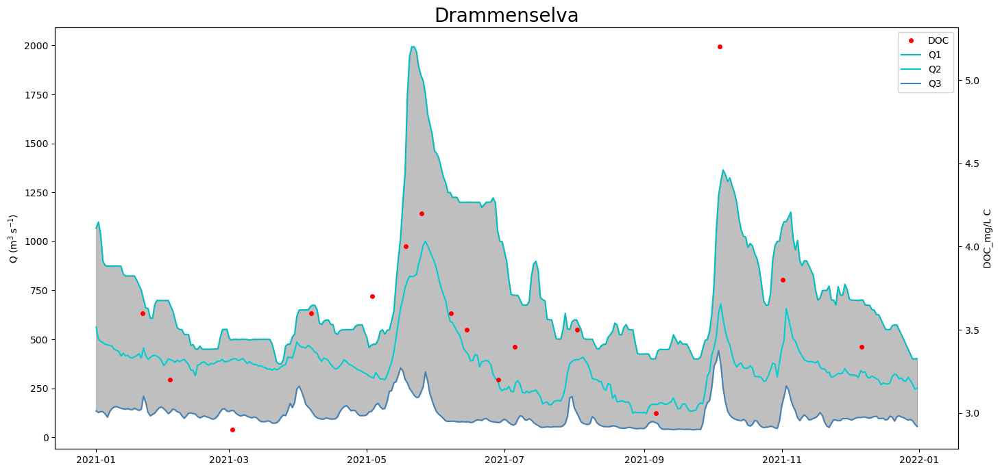

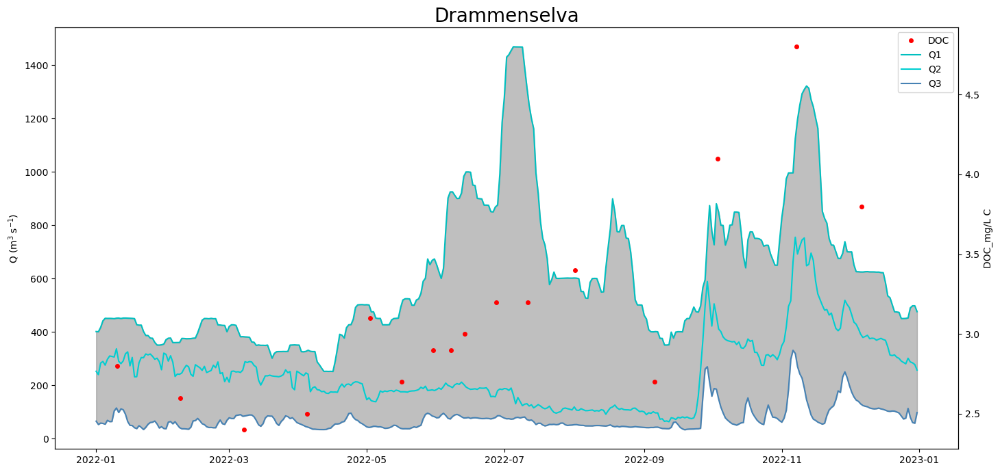

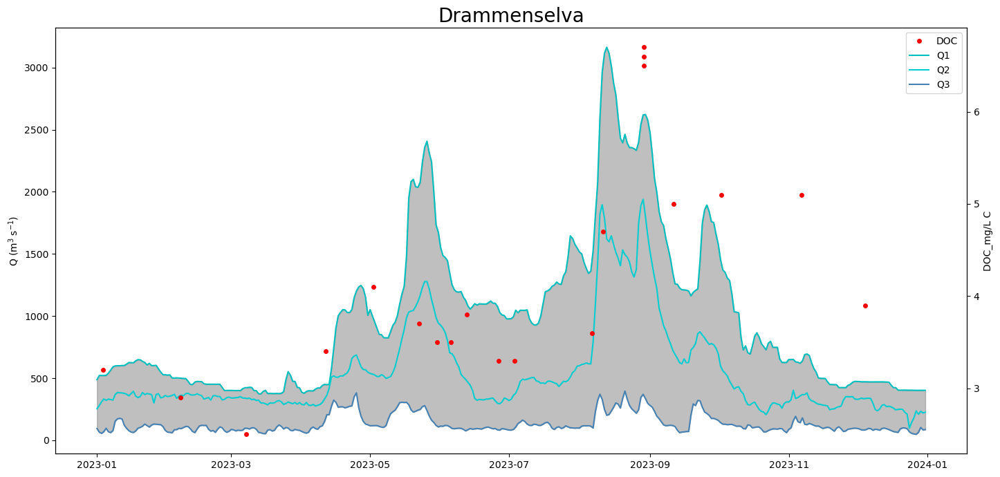

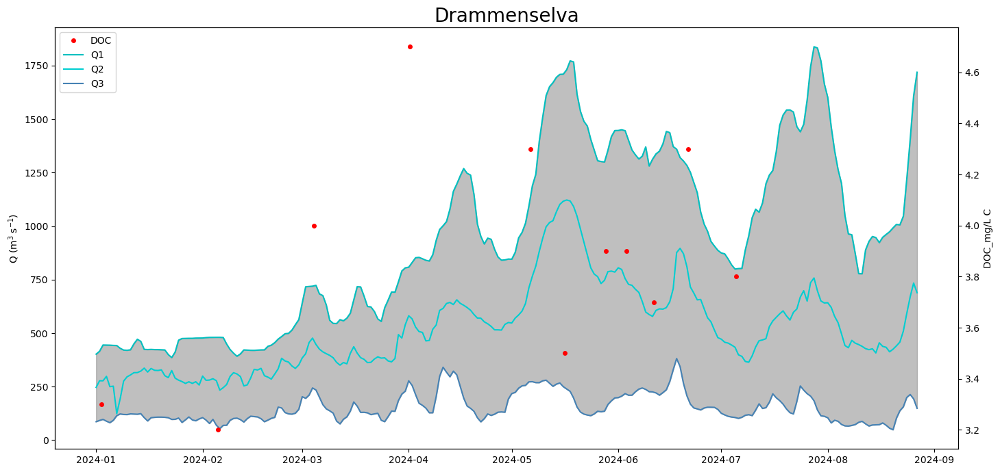

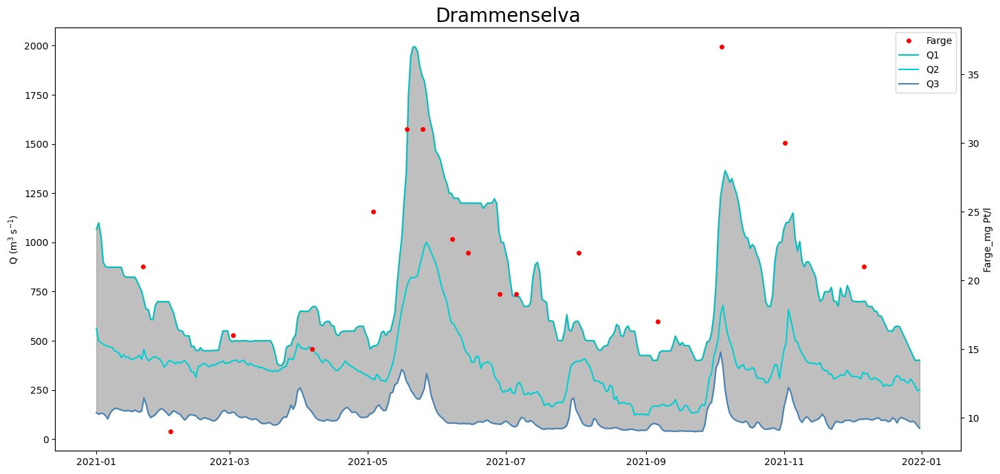

...

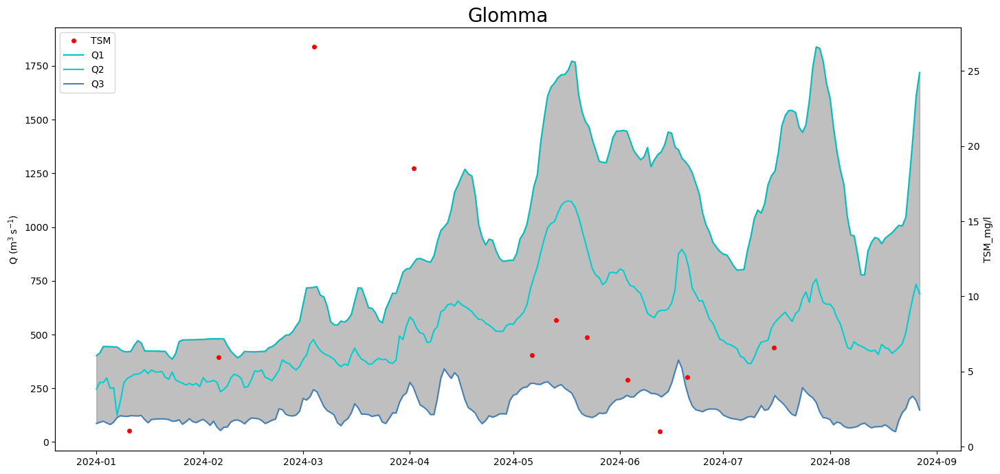

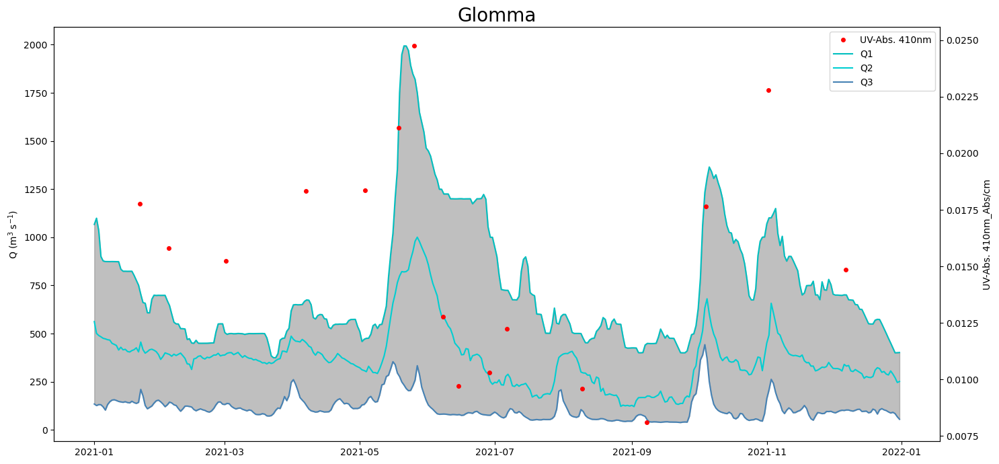

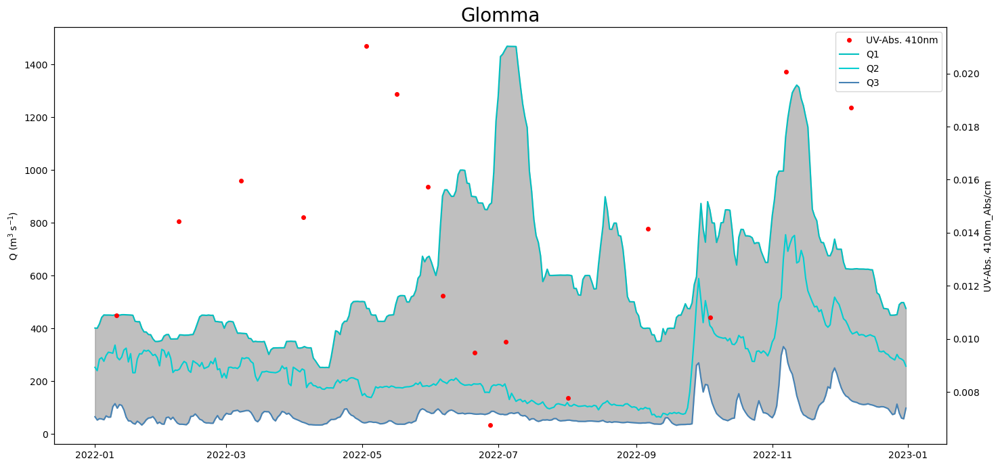

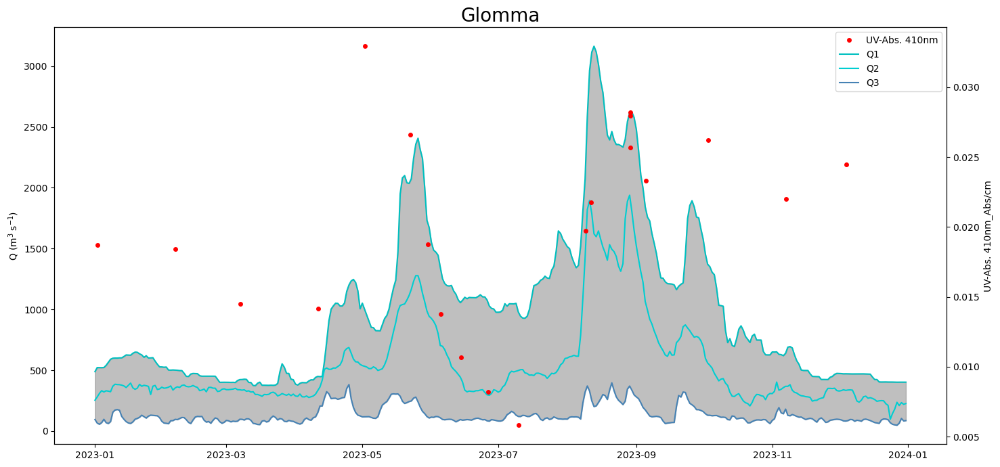

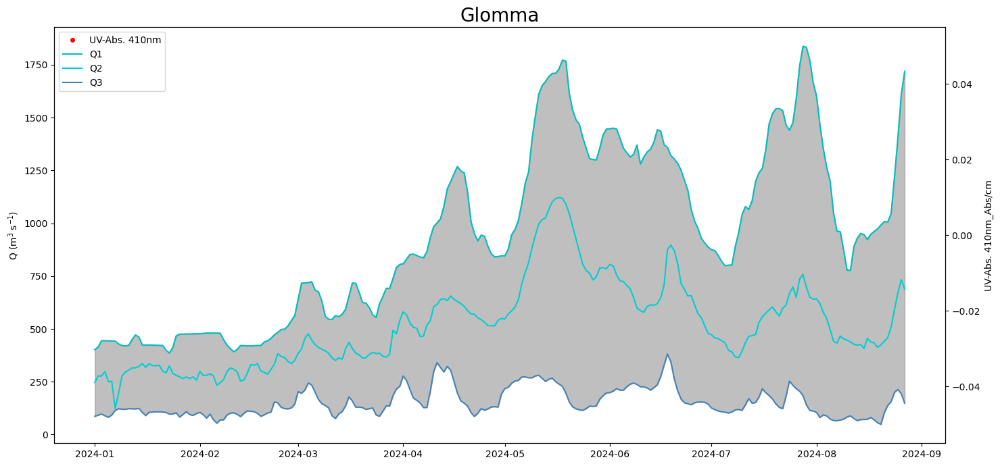

In [ ]:
# Plot all available variables
for station in ['Drammenselva', 'Numedalsl�gen', 'Glomma']:
    for var in wc_vars:
        for year in [2021, 2022, 2023, 2024]:
            plot_q_chem_ts(discharge_df, chem_df, [var], station, year)

## Chem and sensor data - Glomma

In [ ]:
def plot_sensor_chem_ts(
    sensor_df,
    chem_df,
    sensor_var,
    chem_vars,
    year_start,
    y_label=None,
    fname=None,
):
    """
    Plot chem & sensor data on one time series plot
    """

    sensor_color_dict = {
        "CDOMdigitalFinal (�g/L)": "blue",
        "CondValue_Avg (�S/cm)": "darkslategrey",
        "PhValue_Avg (-)": "darkslateblue",
        "Temp_water_Avg (degC)": "peru",
        "Salinity_Avg (-)": "royalblue",
        "Turbidity_Avg (NTU)": "saddlebrown"
    }

    year_start = str(year_start)

    # Ensure the Timestamp column is parsed as datetime and set as index
    sensor_df.reset_index(inplace=True)
    sensor_df['Timestamp'] = pd.to_datetime(sensor_df['Timestamp'])
    sensor_df.set_index('Timestamp', inplace=True)

    # Adjust the date range to match the format of your Timestamp index
    start_date = f"{year_start}-01-31 01:00:00"
    end_date = f"{year_start}-12-31 23:00:00"

    sensor_df_tmp = sensor_df.loc[start_date:end_date]
    chem_df_tmp = chem_df.loc[year_start]

    # Create a figure and subplot
    fig, ax = plt.subplots(figsize=(12, 5))

    ax.plot(
        sensor_df_tmp.index,
        sensor_df_tmp[sensor_var],
        label=sensor_var,
        color=sensor_color_dict[sensor_var],
    )

    # Add labels and title
    sensor_yaxis_dict = {'CDOMdigitalFinal (�g/L)':'CDOM',
                         'CondValue_Avg (�S/cm)': 'Conductivity',
                         'Temp_water_Avg (degC)': 'Water Temp',
                         'Salinity_Avg (-)': 'Salinity',
                         'PhValue_Avg (-)': 'pH',
                         'Turbidity_Avg (NTU)': 'Turbidity'}
    ax.set_ylabel("%s" % sensor_yaxis_dict[sensor_var])

    # Set major ticks locator
    ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))  # tick every month
    # Set major ticks format
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

    plt.xticks(rotation=45)

    # Plot chem data
    ax2 = ax.twinx()

    chem_colours_dict = {0: "r", 1: "mediumvioletred", 2: "orange", 3: "chocolate"}

    for i, var in enumerate(chem_vars):
        chem_name = var.split("_")[0]  # Drop the units
        ax2.plot(
            chem_df_tmp.index,
            chem_df_tmp[var],
            marker="o",
            color=chem_colours_dict[i],
            ms=6,
            linestyle=" ",
            linewidth=0.3,
            label=chem_name,
        )

    ax2.set_ylabel(chem_name)

    # Add legend
    # Get lines and labels from both axes
    lines, labels = ax.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax.legend(lines2 + lines, labels2 + labels, loc='best')

    # For poster only
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)
    ax2.tick_params(axis='y', labelsize=14)

    plt.tight_layout()

    # Show the plot
    plt.show()


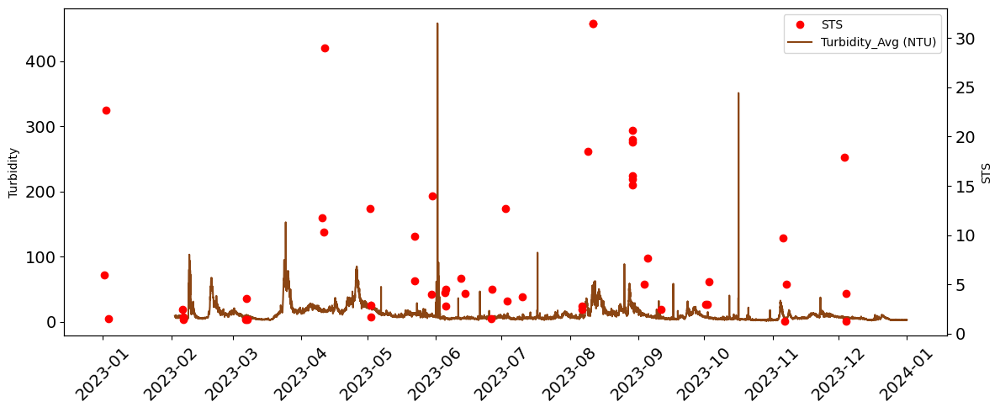

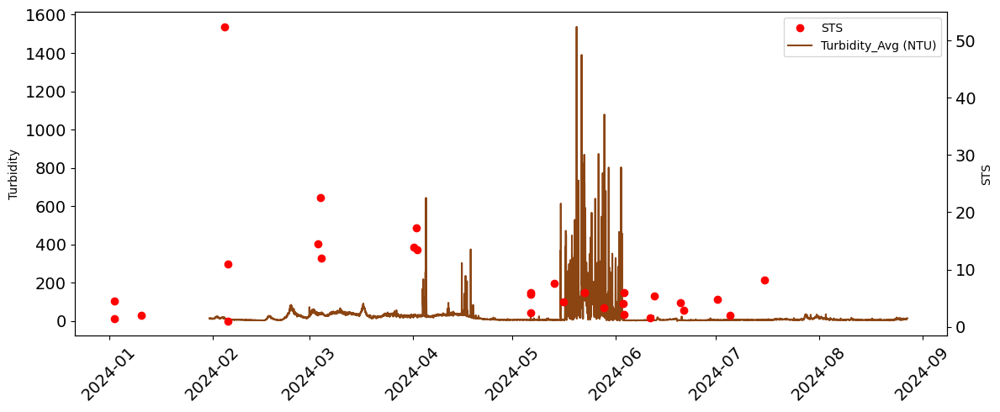

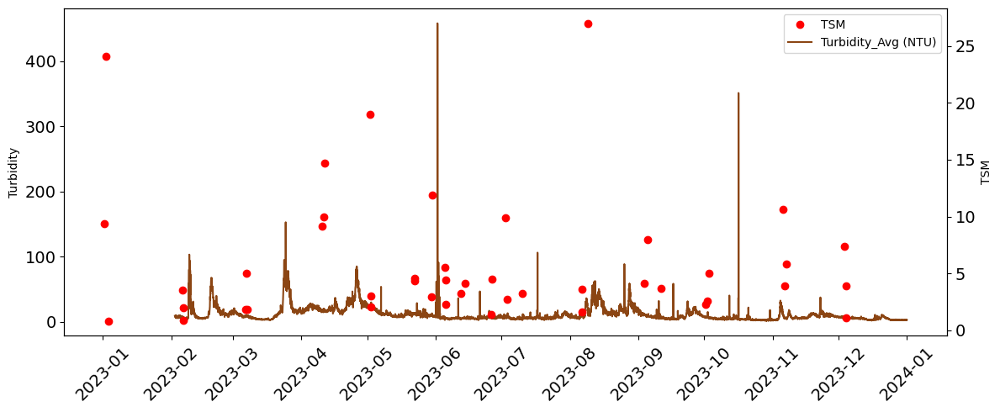

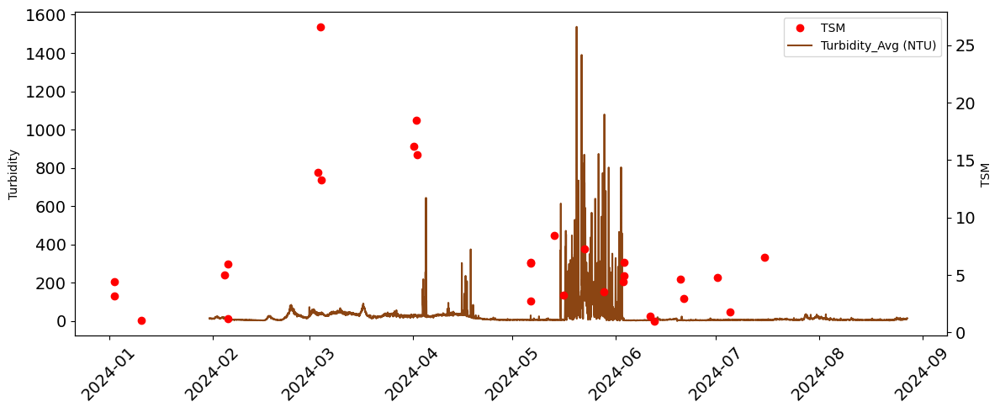

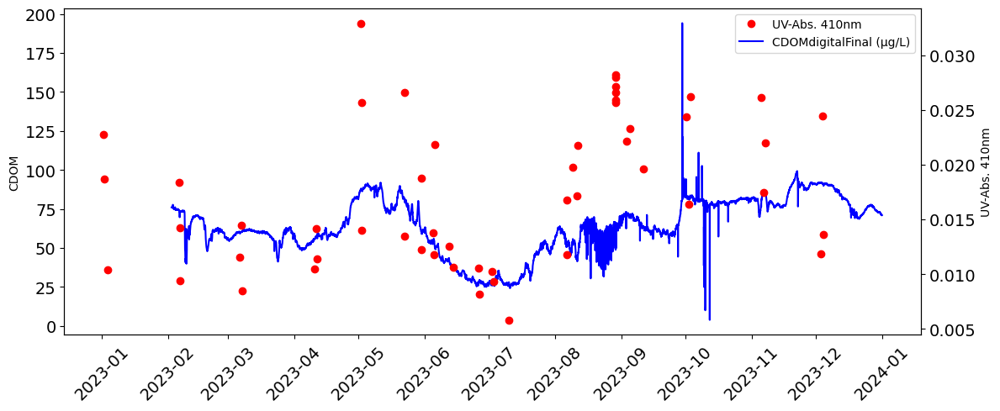

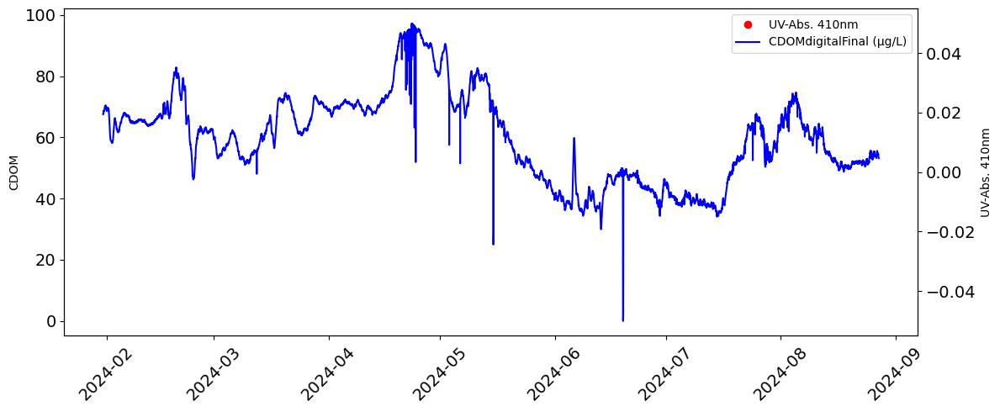

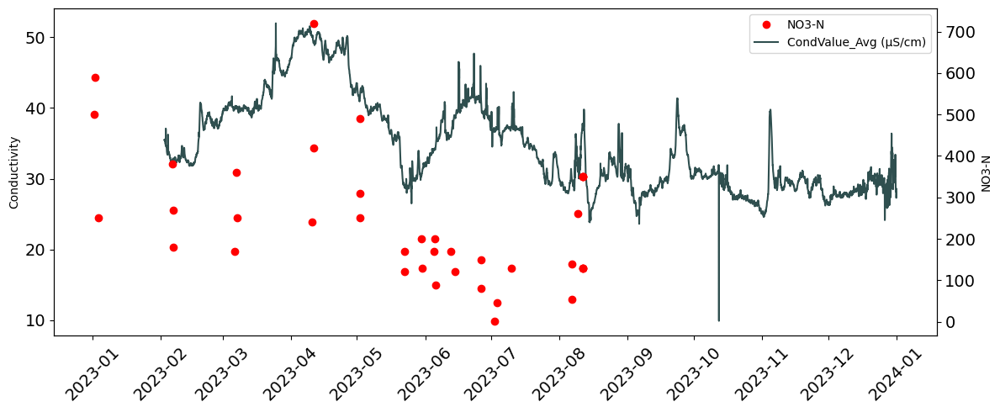

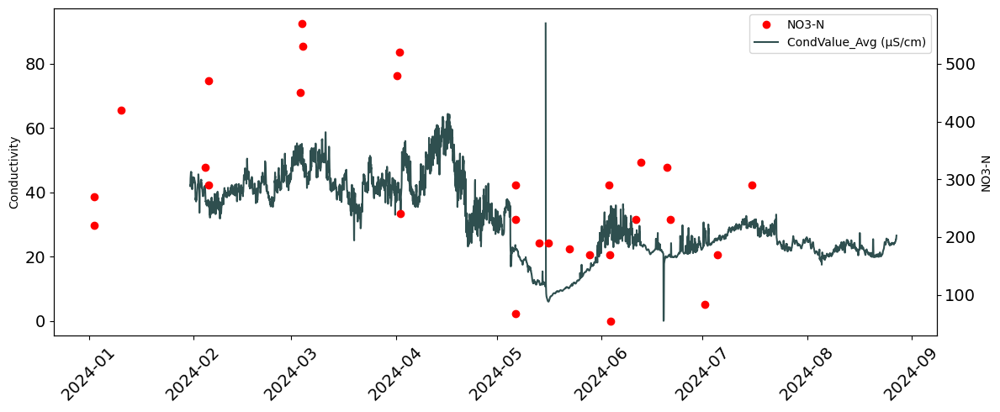

In [ ]:
# Filter the water chemistry DataFrame
start_date = '2023-01-01'
end_date = '2024-08-31'
station_name = 'Glomma v/Sarpefossen'

filtered_chem_df = chem_df[(chem_df['station_name'] == station_name) &
                           (chem_df.index >= start_date) &
                           (chem_df.index <= end_date)]


# Define the combinations you want to plot
combinations = [
    ('Turbidity_Avg (NTU)', ['STS_mg/l']),
    ('Turbidity_Avg (NTU)', ['TSM_mg/l']),
    ('CDOMdigitalFinal (�g/L)', ['UV-Abs. 410nm_Abs/cm']),
    ('CondValue_Avg (�S/cm)', ['NO3-N_�g/l'])
]

# Loop through the combinations and plot
for sensor_var, chem_vars in combinations:
    for year in [2023, 2024]:
        plot_sensor_chem_ts(
            sensor_df,
            chem_df,
            sensor_var,
            chem_vars,
            year
        )

# 3. Look for regressions

## 3a. Chem and Q: Regressions using daily data available for all years
**Note:** I selected discharges based on the dates of the water chemistry dataframe.

In [ ]:
# Join the Water chemistry and discharge dataframe

# Reset index to make 'Date' a column
discharge_df.reset_index(inplace=True)

# Melt discharge dataframe
discharge_long_df = discharge_df.melt(id_vars=['Date'],
                                      var_name='station_name',
                                      value_name='discharge')

# Add a new column for station names to the discharge dataframe
discharge_long_df['station_name'] = discharge_long_df['station_name'].str.replace('discharge_', '')

# Convert date column of the discharge dataframe to datetime format
discharge_long_df['Date'] = pd.to_datetime(discharge_long_df['Date'])

# Rename 'sample_date' to 'Date' in water chemistry dataframe
chem_df.reset_index(inplace=True)
chem_df['sample_date'] = chem_df['sample_date'].dt.date
chem_df.rename(columns={'sample_date': 'Date'}, inplace=True)
chem_df['Date'] = pd.to_datetime(chem_df['Date'])

# Merge the dataframes on 'Date' and 'station_name'
merged_df = pd.merge(chem_df, discharge_long_df,
                     how='inner',
                     left_on=['Date', 'station_name'],
                     right_on=['Date', 'station_name'])

merged_df.head()

,Date,station_id,station_code,station_name,DOC_mg/L C,outlier_DOC_mg/L C,Farge_mg Pt/l,outlier_Farge_mg Pt/l,NH4-N_�g/l,outlier_NH4-N_�g/l,...,outlier_TOTN_�g/l,TOTP/F_�g/l P,outlier_TOTP/F_�g/l P,TOTP_P_�g/l P,outlier_TOTP_P_�g/l P,TSM_mg/l,outlier_TSM_mg/l,UV-Abs. 410nm_Abs/cm,outlier_UV-Abs. 410nm_Abs/cm,discharge
0,1990-01-11,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,0.8,False,NaN,NaN,260.214
1,1990-02-12,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,2.0,False,NaN,NaN,321.638
2,1990-03-13,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,1.4,False,NaN,NaN,323.871
3,1990-04-18,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,1.3,False,NaN,NaN,345.090
4,1990-05-21,40352,DRA1,Drammenselva v/Krokstadelva,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,1.7,False,NaN,NaN,323.871


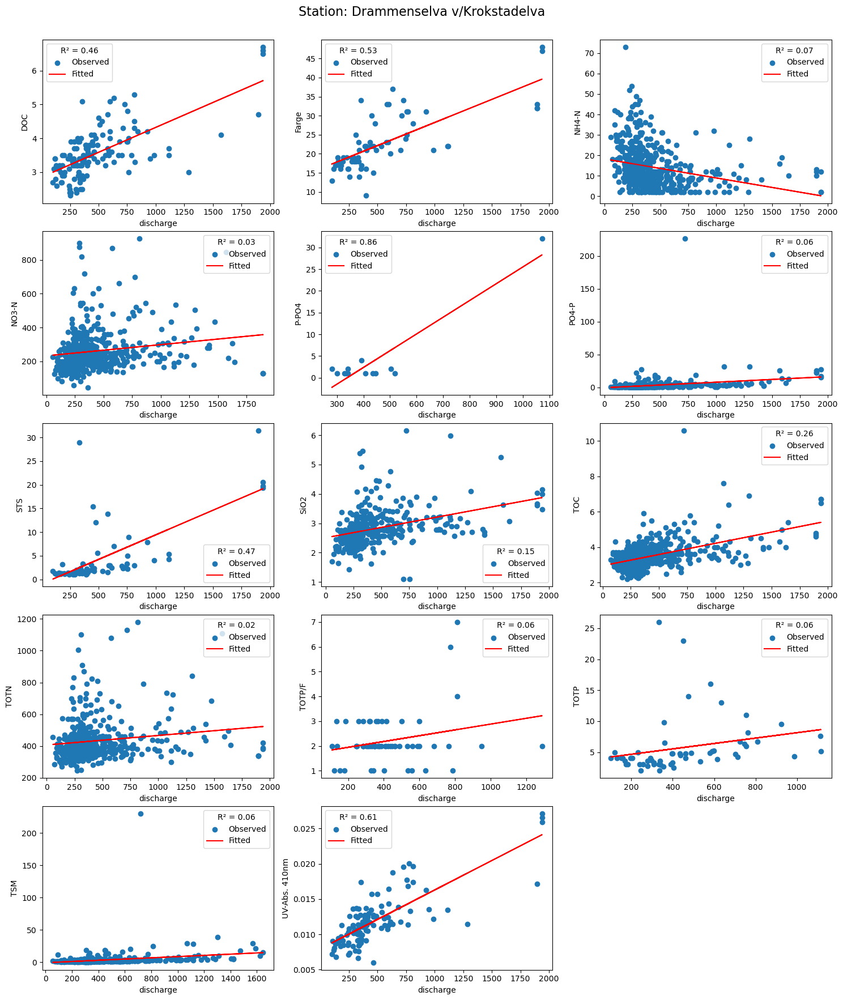

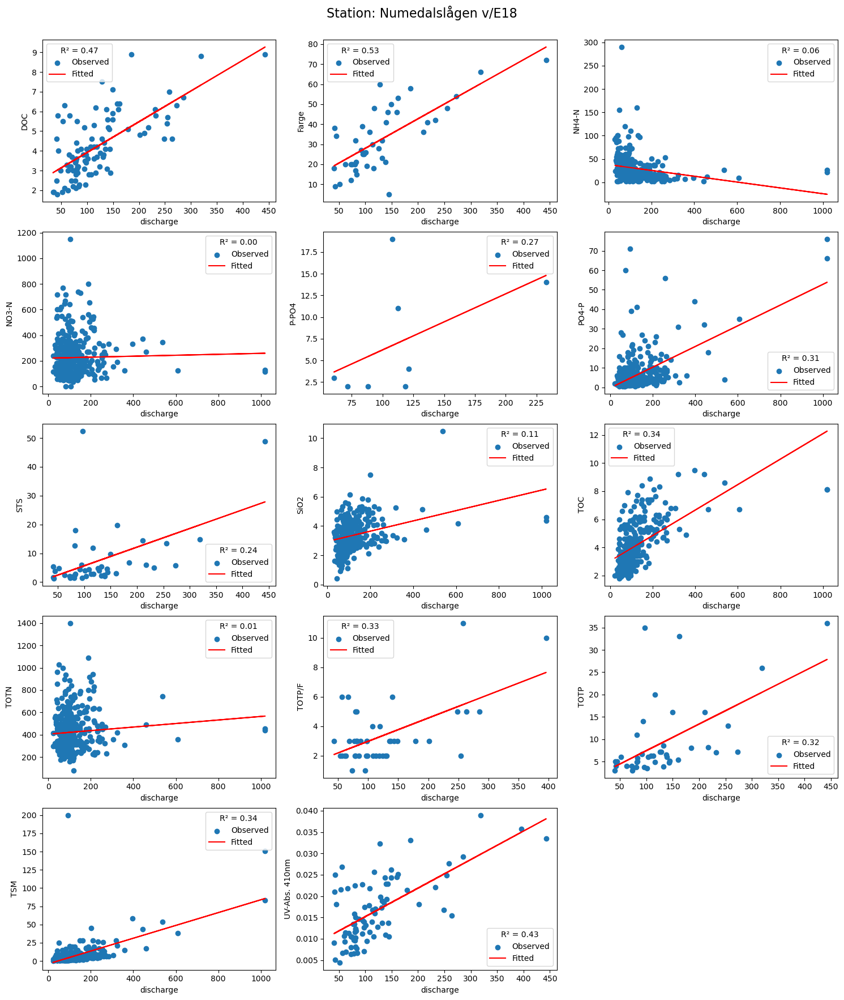

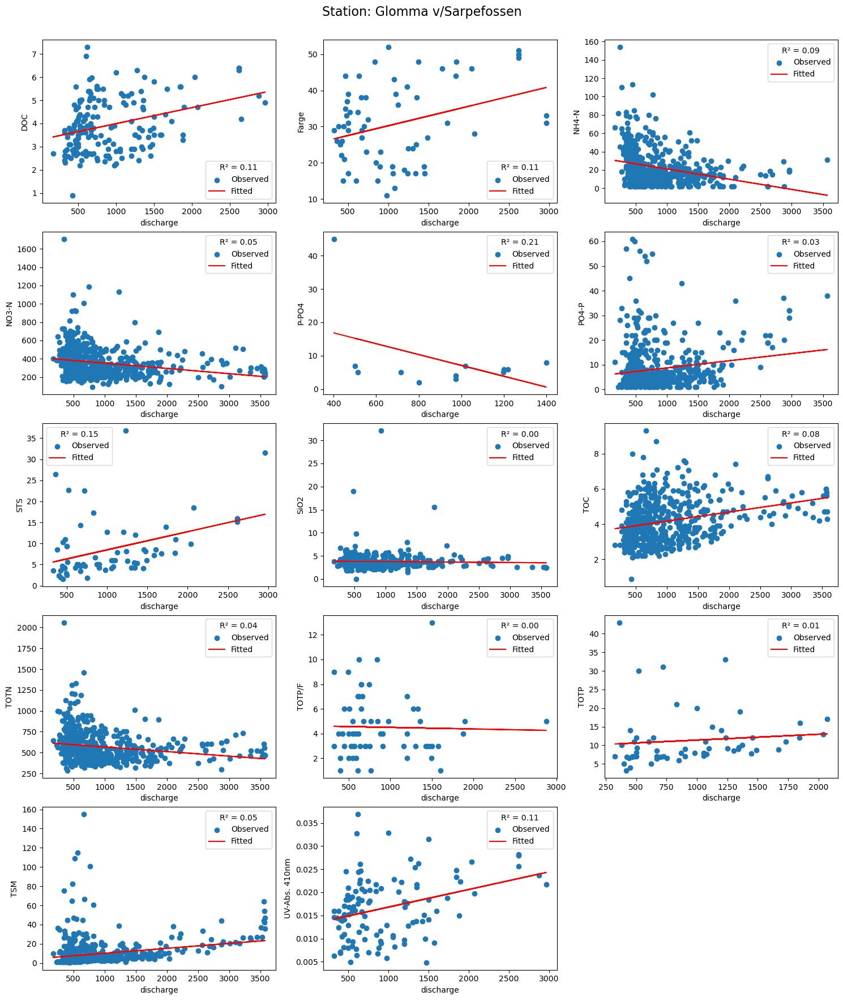

In [ ]:
stations = merged_df['station_name'].unique()

model_r2_coeffs_annual = {}

for station in stations:
    station_df = merged_df[merged_df['station_name'] == station]

    n = len(wc_vars)
    ncols = 3
    nrows = int(np.ceil(n / ncols))

    fig, axs = plt.subplots(nrows, ncols, figsize=(15, 20))
    axs = axs.flatten()

    for i, chem_var in enumerate(wc_vars):
        df = station_df[['Date', chem_var, 'discharge']].dropna()

        if df.empty:
            continue

        X = sm.add_constant(df['discharge'])  # independent variable
        y = df[chem_var]  # dependent variable

        model = sm.OLS(y, X)
        results = model.fit()

        chem_name = chem_var.split("_")[0]

        m, c = results.params['discharge'], results.params['const']
        model_r2_coeffs_annual[(station, chem_name, 'discharge')] = [results.rsquared, m, c]

        axs[i].scatter(df['discharge'], df[chem_var], label='Observed')
        axs[i].plot(df['discharge'], results.fittedvalues, color='red', label='Fitted')
        axs[i].set_xlabel('discharge')
        axs[i].set_ylabel(chem_name)
        # axs[i].set_title(f'{station}')
        r2 = results.rsquared
        axs[i].legend(title=f'R� = {r2:.2f}')

    for j in range(i+1, len(axs)):
        fig.delaxes(axs[j])

    plt.tight_layout()
    plt.subplots_adjust(top=0.85)  # Adjust the top margin to make space for the suptitle
    plt.suptitle(f'Station: {station}', fontsize=16, y=0.88)  # Increase labelpad and adjust y position
    plt.show()


In [ ]:
# Convert r2 values and regression coefficients to a df and save

# Convert the dictionary to a DataFrame
regression_df = pd.DataFrame(
    [(k[0], k[1], v[0], v[1], v[2]) for k, v in model_r2_coeffs_annual.items()],
    columns=["Station_name", "Chem_var", "R2", "m", "c"],
)

# regression_df.round(3).to_csv(r'../data/flux_calculations/chem-var_cont-var_regression_results_drop-outliers.csv')

# Show rows where R2 > 0.2
regression_df.loc[regression_df['R2'] >= 0.2].round(2)

,Station_name,Chem_var,R2,m,c
0,Drammenselva v/Krokstadelva,DOC,0.46,0.00,2.85
1,Drammenselva v/Krokstadelva,Farge,0.53,0.01,16.11
4,Drammenselva v/Krokstadelva,P-PO4,0.86,0.04,-13.04
6,Drammenselva v/Krokstadelva,STS,0.47,0.01,-0.97
8,Drammenselva v/Krokstadelva,TOC,0.26,0.00,2.96
13,Drammenselva v/Krokstadelva,UV-Abs. 410nm,0.61,0.00,0.01
14,Numedalsl�gen v/E18,DOC,0.47,0.02,2.36
15,Numedalsl�gen v/E18,Farge,0.53,0.15,13.21
18,Numedalsl�gen v/E18,P-PO4,0.27,0.06,-0.27
19,Numedalsl�gen v/E18,PO4-P,0.31,0.05,-0.29


## 3b. Chem and Q: Regressions using daily data available for each season

In [ ]:
# Assign seasons
def get_season(date):
    year = date.year
    if date.month in [12, 1, 2]:
        season = 'Winter'
        if date.month == 12:
            year += 1
    elif date.month in [3, 4, 5]:
        season = 'Spring'
    elif date.month in [6, 7, 8]:
        season = 'Summer'
    else:
        season = 'Fall'
    return f'{season} {year}'

# Add a season column
merged_df['Season'] = merged_df['Date'].apply(get_season)

# Create dataframes for each season
winter_df = merged_df[merged_df['Season'].str.contains('Winter')]
spring_df = merged_df[merged_df['Season'].str.contains('Spring')]
summer_df = merged_df[merged_df['Season'].str.contains('Summer')]
fall_df = merged_df[merged_df['Season'].str.contains('Fall')]

# Display the first few rows of each dataframe
print("Winter DataFrame:")
print(winter_df.head())
print("\nSpring DataFrame:")
print(spring_df.head())
print("\nSummer DataFrame:")
print(summer_df.head())
print("\nFall DataFrame:")
print(fall_df.head())

Winter DataFrame:
         Date  station_id station_code                 station_name  \
0  1990-01-11       40352         DRA1  Drammenselva v/Krokstadelva   
1  1990-02-12       40352         DRA1  Drammenselva v/Krokstadelva   
11 1990-12-12       40352         DRA1  Drammenselva v/Krokstadelva   
12 1991-01-21       40352         DRA1  Drammenselva v/Krokstadelva   
13 1991-02-10       40352         DRA1  Drammenselva v/Krokstadelva   

    DOC_mg/L C outlier_DOC_mg/L C  Farge_mg Pt/l outlier_Farge_mg Pt/l  \
0          NaN                NaN            NaN                   NaN   
1          NaN                NaN            NaN                   NaN   
11         NaN                NaN            NaN                   NaN   
12         NaN                NaN            NaN                   NaN   
13         NaN                NaN            NaN                   NaN   

    NH4-N_�g/l outlier_NH4-N_�g/l  ...  TOTP/F_�g/l P outlier_TOTP/F_�g/l P  \
0          NaN                N

In [1]:
def plot_seasonal_regression(input_df, season):
  stations = input_df['station_name'].unique()

  model_r2_coeffs = {}

  for station in stations:
      station_df = input_df[input_df['station_name'] == station]

      n = len(wc_vars)
      ncols = 3
      nrows = int(np.ceil(n / ncols))

      fig, axs = plt.subplots(nrows, ncols, figsize=(15, 20))
      axs = axs.flatten()

      for i, chem_var in enumerate(wc_vars):
          df = station_df[['Date', chem_var, 'discharge']].dropna()

          if df.empty:
              continue

          X = sm.add_constant(df['discharge'])  # independent variable
          y = df[chem_var]  # dependent variable

          model = sm.OLS(y, X)
          results = model.fit()

          chem_name = chem_var.split("_")[0]

          # Check if 'const' is in results.params
          if 'const' in results.params:
              m, c = results.params['discharge'], results.params['const']
          else:
              m, c = results.params['discharge'], 0  # Default to 0 if 'const' is not found

          model_r2_coeffs[(station, chem_name, 'discharge')] = [results.rsquared, m, c]

          axs[i].scatter(df['discharge'], df[chem_var], label='Observed')
          axs[i].plot(df['discharge'], results.fittedvalues, color='red', label='Fitted')
          axs[i].set_xlabel(f'{season} discharge')
          axs[i].set_ylabel(f'{season} {chem_name}')
          r2 = results.rsquared
          axs[i].legend(title=f'R� = {r2:.2f}')

      for j in range(i+1, len(axs)):
          fig.delaxes(axs[j])

      plt.tight_layout()
      plt.subplots_adjust(top=0.85)  # Adjust the top margin to make space for the suptitle
      plt.suptitle(f'Station: {station}', fontsize=16, y=0.88)  # Increase labelpad and adjust y position
      plt.show()

      # Convert r2 values and regression coefficients to a df and save

      # Convert the dictionary to a DataFrame
      regression_df = pd.DataFrame(
          [(k[0], k[1], v[0], v[1], v[2]) for k, v in model_r2_coeffs.items()],
          columns=["Station_name", "Chem_var", "R2", "m", "c"],
      )

      # regression_df.round(3).to_csv(r'../data/flux_calculations/chem-var_cont-var_regression_results_drop-outliers.csv')

      # Show rows where R2 > 0.2
      regression_df.loc[regression_df['R2'] >= 0.2].round(2)



In [ ]:
plot_seasonal_regression(winter_df, "winter")

In [ ]:
plot_seasonal_regression(spring_df, "spring")

In [ ]:
plot_seasonal_regression(summer_df, "summer")

In [ ]:
plot_seasonal_regression(fall_df, "fall")